# Comprehensive analysis of hypothalamic microglia across multiple

datasets

Evgenii O. Tretiakov  
Invalid Date

In [1]:
#| label: setup
#| include: false
# Set random seeds for reproducibility
import random
import numpy as np
import scanpy as sc

random.seed(42)
np.random.seed(42)
sc.settings.seed = 42

# Other imports
import os
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import statsmodels.stats.multitest as mt

In [2]:
#| label: load-data
# Microglia markers based on literature
microglia_markers = [
    "Aif1", "Itgam", "Cx3cr1", "P2ry12", "Tmem119",
    "Hexb", "Csf1r", "Trem2", "C1qa", "C1qb", "C1qc",
    "Cd68", "Ptprc", "Fcrls", "Cd14", "Tgfbr1", "Sall1",
    "Olfml3", "Siglech", "Gpr34", "Mafb", "Cd33", "Trem2"
]

# Create dataset mapping
dataset_info = {
    'PRJNA1018579': {'name': 'Guo2024_POA', 'region': 'POA'},
    'PRJNA971261': {'name': 'Jovanovic2022_DMH', 'region': 'DMH'},
    'PRJNA872019': {'name': 'Tang2023_DMH_SCN', 'region': 'DMH_SCN'},  # Taking first region
    'PRJNA847050': {'name': 'lutomska2022_Arc', 'region': 'Arc'},
    'PRJNA815819': {'name': 'pool2022_MnPO', 'region': 'MnPO'},
    'PRJNA798401': {'name': 'liu2022_VMHvl', 'region': 'VMHvl'},
    'PRJNA779749': {'name': 'hajdarovic2022_Hypoth', 'region': 'Hypoth'},
    'PRJNA723345': {'name': 'rupp2021_MBH', 'region': 'MBH'},
    'PRJNA722418': {'name': 'affinati2021_VMH', 'region': 'VMH'},
    'PRJNA705596': {'name': 'morris2021_SCN', 'region': 'SCN'},
    'PRJNA679294': {'name': 'lopez2021_PVN', 'region': 'PVN'},
    'PRJNA626601': {'name': 'Bentsen2020_MBH', 'region': 'MBH'},  # Taking first region
    'PRJNA611624': {'name': 'mickelsen2020_VPH', 'region': 'VPH'},
    'PRJNA604055': {'name': 'deng2020_Arc', 'region': 'Arc'},
    'PRJNA548917': {'name': 'romanov2020_Hypoth', 'region': 'Hypoth-dev'},
    'PRJNA548532': {'name': 'wen2020_SCN', 'region': 'SCN'},
    'PRJNA547712': {'name': 'kim2020_Hypoth', 'region': 'Hypoth-dev'},
    'PRJNA515063': {'name': 'mickelsen2019_LHA', 'region': 'LHA'},
    'PRJNA453138': {'name': 'moffitt2018_POA', 'region': 'POA'},
    'PRJNA438862': {'name': 'zeisel2018_Hypoth', 'region': 'Hypoth-brain'}
}

# Function to load and preprocess dataset
def load_dataset(file_path):
    adata = sc.read_h5ad(file_path)
    project = Path(file_path).stem.split('-')[0]
    
    # Add dataset name and region information
    if project in dataset_info:
        adata.obs['dataset'] = dataset_info[project]['name']
        adata.obs['region'] = dataset_info[project]['region']
    else:
        adata.obs['dataset'] = project
        adata.obs['region'] = 'Unknown'
    
    return adata

# Load all datasets
data_dir = Path("/home/etretiakov/src/MicrogliaTRAP/data/")
datasets = []
for file in data_dir.glob("*-whole.h5ad"):
    print(f"Loading {file.name}")
    datasets.append(load_dataset(file))

# Concatenate all datasets
adata_combined = datasets[0].concatenate(
    datasets[1:],
    join='outer',
    batch_key='dataset'
)

print(f"Combined dataset shape: {adata_combined.shape}")

Loading PRJNA847050-whole.h5ad
Loading PRJNA815819-whole.h5ad
Loading PRJNA798401-whole.h5ad
Loading PRJNA723345-whole.h5ad
Loading PRJNA722418-whole.h5ad
Loading PRJNA705596-whole.h5ad
Loading PRJNA679294-whole.h5ad
Loading PRJNA611624-whole.h5ad
Loading PRJNA604055-whole.h5ad
Loading PRJNA548532-whole.h5ad
Loading PRJNA515063-whole.h5ad
Loading PRJNA453138-whole.h5ad

/tmp/ipykernel_21742/4024288810.py:56: FutureWarning:

Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html


Combined dataset shape: (271739, 27597)

In [3]:
#| label: filter-microglia
def identify_microglia(adata):
    """Identify microglia based on marker expression and annotation"""
    # Filter markers present in the dataset
    available_markers = [m for m in microglia_markers if m in adata.var_names]
    
    # Calculate marker score
    marker_expr = adata[:, available_markers].X.toarray()
    marker_score = np.sum(marker_expr > 0, axis=1) / len(available_markers)
    
    # Identify cells with high marker expression
    high_marker_expr = marker_score >= 0.3  # At least 30% of markers expressed
    
    # Combined with existing annotation if available
    is_microglia = (
        high_marker_expr |
        adata.obs['ora_celltype'].isin(['Microglia'])
    )
    
    return is_microglia

# Filter for microglia
is_microglia = identify_microglia(adata_combined)
adata_microglia = adata_combined[is_microglia].copy()

print(f"Number of identified microglia: {adata_microglia.n_obs}")

Number of identified microglia: 12352

In [4]:
#| label: preprocess-microglia
#| code-summary: Normalize and process microglial expression data
# Normalize and process
sc.pp.normalize_total(adata_microglia)
sc.pp.log1p(adata_microglia)
sc.pp.highly_variable_genes(
    adata_microglia,
    n_top_genes=2000,
    batch_key='dataset'
)

# Run PCA
sc.pp.scale(adata_microglia)
sc.tl.pca(adata_microglia)

/opt/conda/lib/python3.12/site-packages/numba/core/dispatcher.py:244: UserWarning:

Numba extension module 'numba_scipy' failed to load due to 'ValueError(No function 'betainc' found in __pyx_capi__ of 'scipy.special.cython_special')'.


/tmp/ipykernel_21742/3940727208.py:4: FutureWarning:

In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.


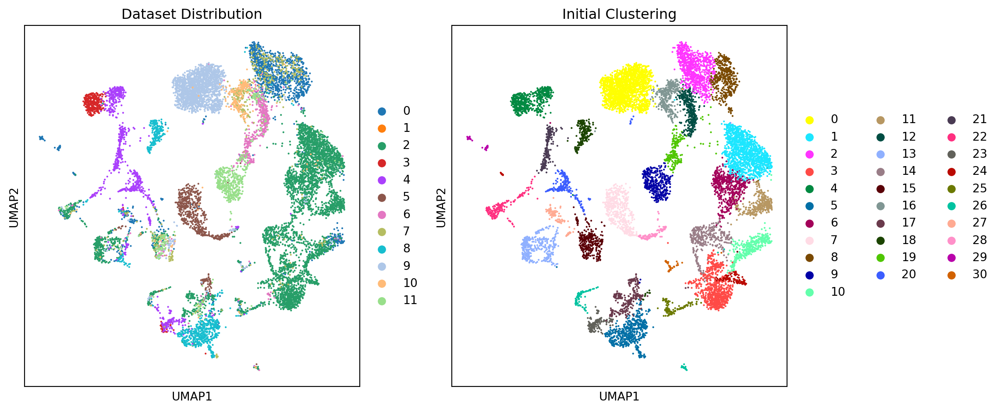

In [5]:
#| label: fig-initial-clustering
#| fig-cap: Initial clustering analysis of hypothalamic microglia. (A) UMAP visualization colored by dataset origin shows batch effects before integration. (B) Initial Leiden clustering reveals potential microglial subpopulations. Colors represent distinct clusters identified by the algorithm.
# Run UMAP and clustering
sc.pp.neighbors(adata_microglia)
sc.tl.umap(adata_microglia)
sc.tl.leiden(adata_microglia)

# Plot results
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
sc.pl.umap(adata_microglia, color='dataset', ax=ax1, show=False, title='Dataset Distribution')
sc.pl.umap(adata_microglia, color='leiden', ax=ax2, show=False, title='Initial Clustering')
plt.tight_layout()

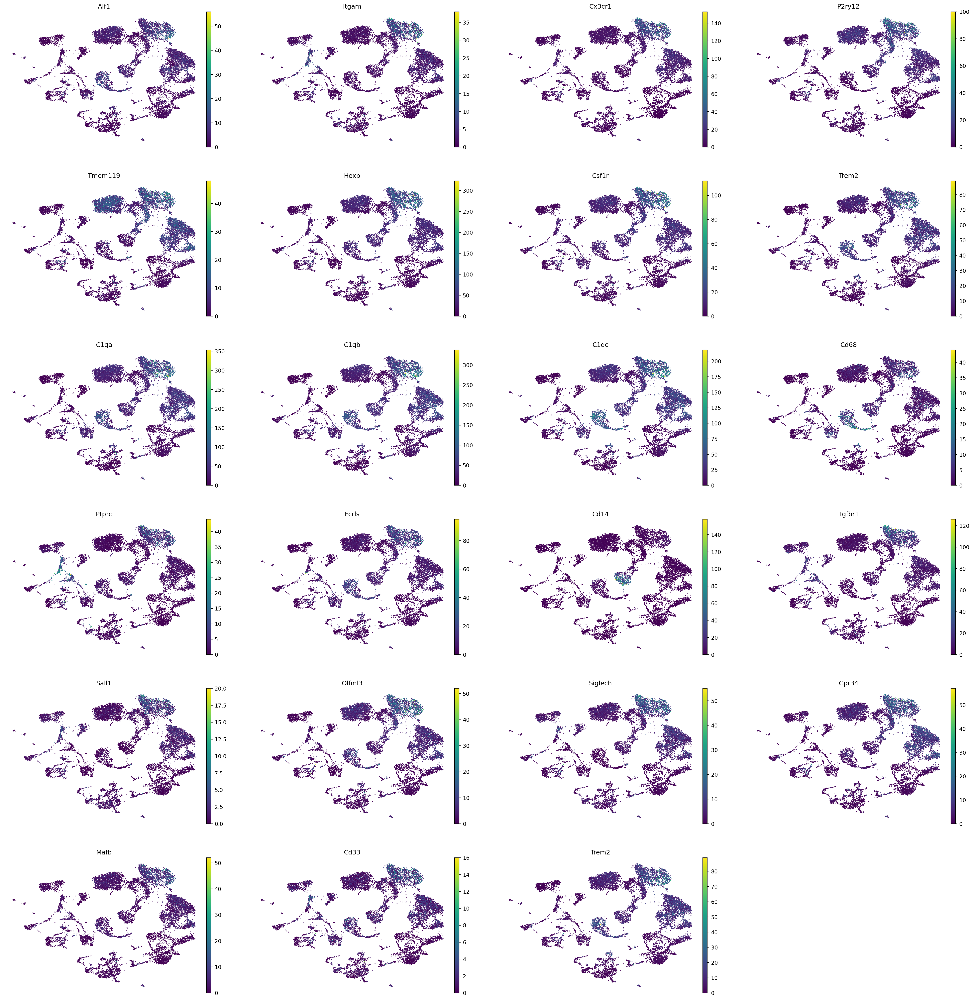

In [6]:
#| label: fig-marker-expression
#| fig-cap: Expression patterns of canonical microglial markers across identified clusters. UMAP visualizations showing the distribution of key microglial marker genes, revealing heterogeneous expression patterns across the population before integration.
# Plot marker genes
sc.pl.umap(
    adata_microglia,
    color=microglia_markers,
    frameon=False,
    save='_init_markers.pdf'
)

In [7]:
#| label: integrate-datasets
#| code-summary: Perform integration
# Harmony integration
import harmonypy

sc.external.pp.harmony_integrate(
    adata_microglia,
    'dataset',
    max_iter_harmony=20
)

# Recompute UMAP on integrated data
sc.pp.neighbors(adata_microglia, use_rep='X_pca_harmony')
sc.tl.umap(adata_microglia)
sc.tl.leiden(adata_microglia, key_added='leiden_integrated')

2025-02-05 15:41:32,418 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-02-05 15:41:49,309 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-02-05 15:41:49,797 - harmonypy - INFO - Iteration 1 of 20
2025-02-05 15:42:45,393 - harmonypy - INFO - Iteration 2 of 20
2025-02-05 15:43:43,992 - harmonypy - INFO - Iteration 3 of 20
2025-02-05 15:44:41,591 - harmonypy - INFO - Iteration 4 of 20
2025-02-05 15:45:39,288 - harmonypy - INFO - Iteration 5 of 20
2025-02-05 15:46:32,091 - harmonypy - INFO - Iteration 6 of 20
2025-02-05 15:47:11,691 - harmonypy - INFO - Iteration 7 of 20
2025-02-05 15:48:04,388 - harmonypy - INFO - Iteration 8 of 20
2025-02-05 15:48:57,191 - harmonypy - INFO - Iteration 9 of 20
2025-02-05 15:49:40,196 - harmonypy - INFO - Iteration 10 of 20
2025-02-05 15:50:30,392 - harmonypy - INFO - Iteration 11 of 20
2025-02-05 15:51:05,386 - harmonypy - INFO - Converged after 11 iterations

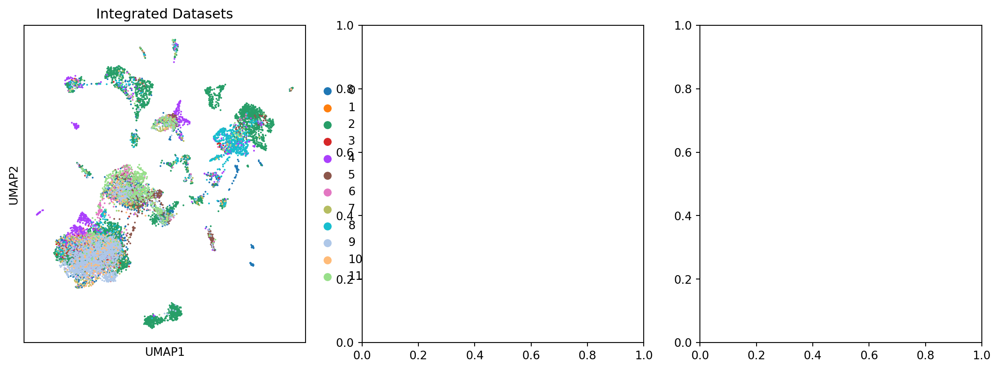

In [8]:
#| label: fig-integrated-analysis
#| fig-cap: Analysis of batch-corrected microglial data. (A) UMAP visualization after integration shows reduced batch effects. (B) Refined clustering based on integrated data reveals distinct microglial subpopulations. (C) Distribution of cells by hypothalamic region demonstrates regional heterogeneity of microglia.
# Create three-panel plot
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

# Dataset distribution after integration
sc.pl.umap(
    adata_microglia,
    color='dataset',
    ax=ax1,
    show=True,
    title='Integrated Datasets',
    save='_integrated_datasets.pdf'
)

# Integrated clustering
sc.pl.umap(
    adata_microglia,
    color='leiden_integrated',
    ax=ax2,
    show=True,
    title='Integrated Clusters',
    save='_integrated_clusters.pdf'
)

# Regional distribution
sc.pl.umap(
    adata_microglia,
    color='region',
    ax=ax3,
    show=True,
    title='Regional Distribution',
    save='_integrated_regions.pdf'
)

plt.tight_layout()
plt.show()

/opt/conda/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning:

invalid value encountered in log2

/opt/conda/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning:

invalid value encountered in log2

/opt/conda/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning:

invalid value encountered in log2

/opt/conda/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning:

invalid value encountered in log2

/opt/conda/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning:

invalid value encountered in log2

/opt/conda/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning:

invalid value encountered in log2

/opt/conda/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning:

invalid value encountered in log2

/opt/conda/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:4

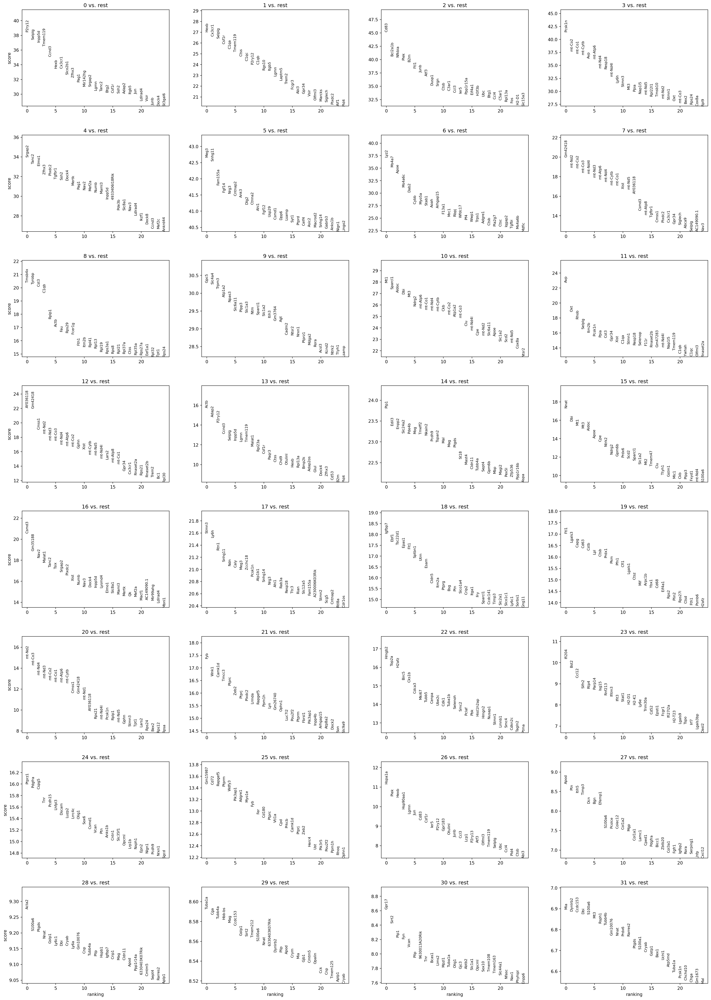

In [9]:
#| label: fig-cluster-markers
#| fig-cap: Differential expression analysis of integrated clusters. Plot shows the top 25 differentially expressed genes per cluster identified using Wilcoxon rank-sum test. Genes are ordered by average log fold change, and expression values are z-scored per gene.
# Find markers for each cluster
sc.tl.rank_genes_groups(
    adata_microglia,
    'leiden_integrated',
    method='wilcoxon',
    use_raw=False
)

# Plot top markers
sc.pl.rank_genes_groups(
    adata_microglia,
    n_genes=25,
    sharey=False,
    save='_quant_markers.pdf'
)

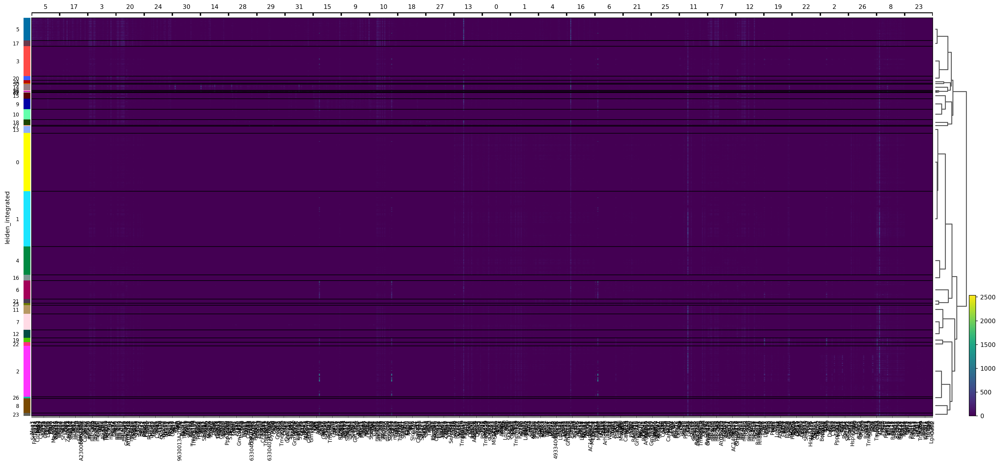

In [10]:
#| label: fig-heatmap-cluster-markers
#| fig-cap: Differential expression analysis of integrated clusters. Heatmap shows the top 25 differentially expressed genes per cluster identified using Wilcoxon rank-sum test. Genes are ordered by average log fold change, and expression values are z-scored per gene.
# Calculate dendrogram first
sc.tl.dendrogram(adata_microglia, groupby='leiden_integrated')


# Plot top markers
sc.pl.rank_genes_groups_heatmap(
    adata_microglia,
    n_genes=25,
    show_gene_labels=True,
    figsize=(28, 12)
)

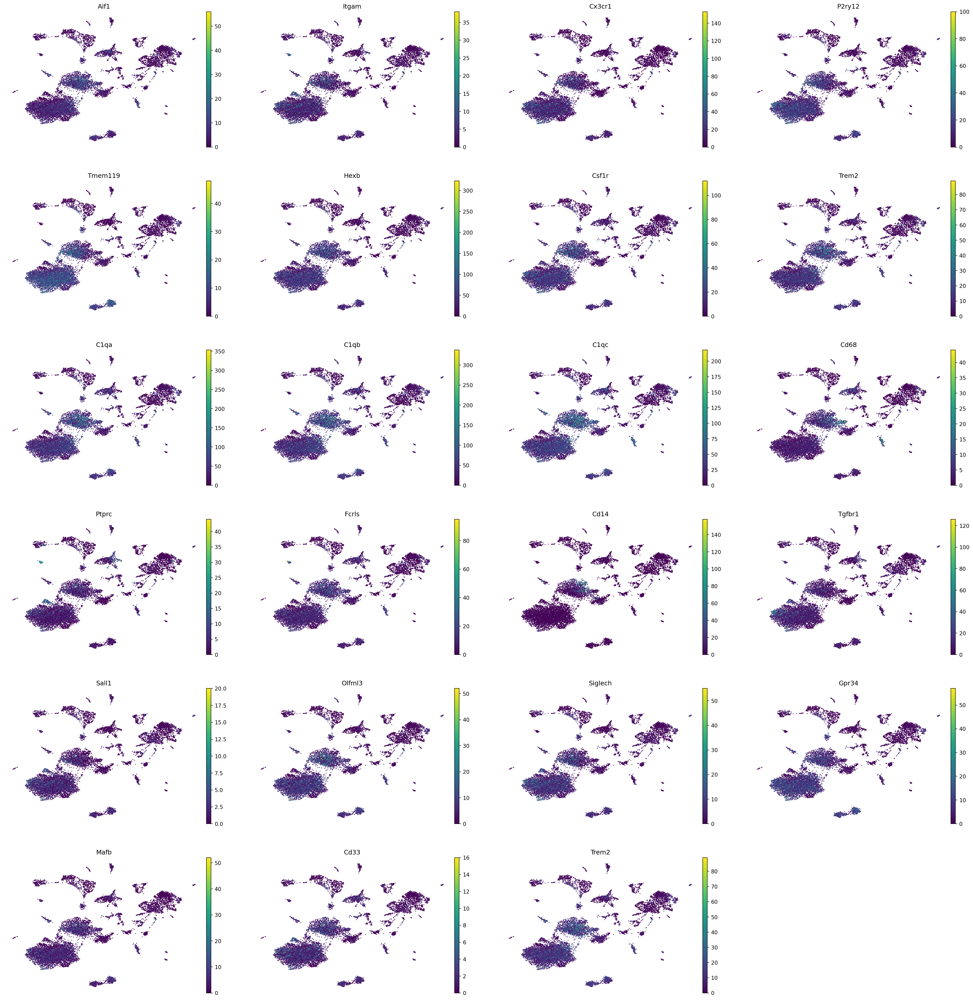

In [11]:
#| label: fig-refined-marker-expression
#| fig-cap: Expression patterns of canonical microglial markers across refined clusters. UMAP visualizations showing the distribution of key microglial marker genes, revealing heterogeneous expression patterns across hypothalamic regions
# Plot marker genes
sc.pl.umap(
    adata_microglia,
    color=microglia_markers,
    frameon=False,
    save='_integrated_markers.pdf'
)

In [12]:
#| label: save-results
# Create output directories
output_dir = Path("output")
output_dir.mkdir(exist_ok=True)

# Save processed data
adata_microglia.write(
    output_dir / "microglia_integrated.h5ad",
    compression="gzip"
)

# Save cluster annotations
pd.DataFrame(adata_microglia.obs).to_csv(
    output_dir / "microglia_metadata.csv"
)

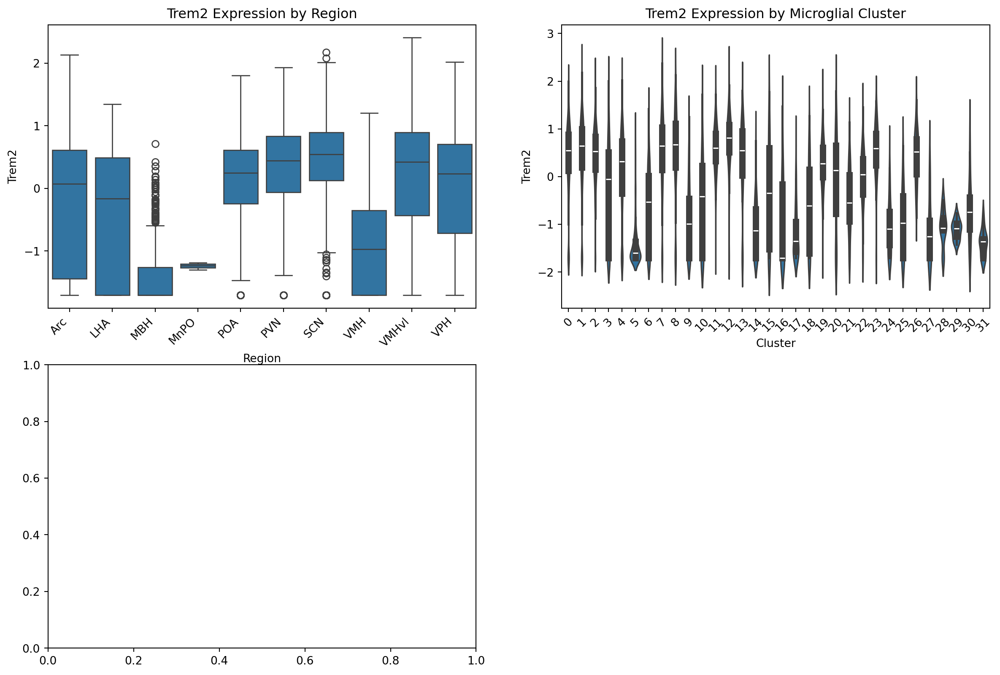

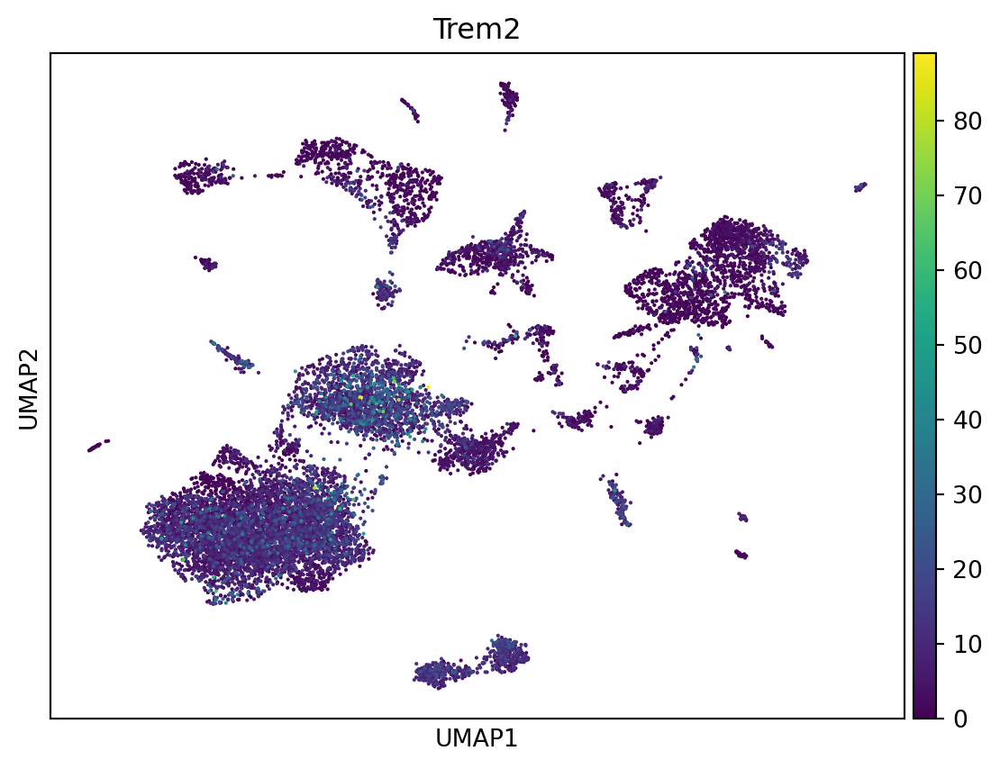

In [13]:
#| label: fig-trem2-analysis
import seaborn as sns
import matplotlib.pyplot as plt

# Analysis of Trem2 expression across regions
def analyze_trem2(adata):
    # Get Trem2 expression
    trem2_expr = pd.DataFrame({
        'Trem2': adata[:, 'Trem2'].X.toarray().flatten(),
        'Region': adata.obs['region'],
        'Dataset': adata.obs['dataset'],
        'Cluster': adata.obs['leiden_integrated']
    })
    
    # Create figure with multiple panels
    fig = plt.figure(figsize=(15, 10))
    
    # 1. Boxplot of Trem2 expression by region
    plt.subplot(2, 2, 1)
    sns.boxplot(data=trem2_expr, x='Region', y='Trem2')
    plt.xticks(rotation=45, ha='right')
    plt.title('Trem2 Expression by Region')
    
    # 2. Violin plot of Trem2 expression by cluster
    plt.subplot(2, 2, 2)
    sns.violinplot(data=trem2_expr, x='Cluster', y='Trem2')
    plt.xticks(rotation=45)
    plt.title('Trem2 Expression by Microglial Cluster')
    
    # 3. UMAP colored by Trem2 expression
    plt.subplot(2, 2, 3)
    sc.pl.umap(adata, color='Trem2', show=True)
    plt.title('UMAP: Trem2 Expression')
    
    # 4. Correlation with other microglial markers
    plt.subplot(2, 2, 4)
    marker_correlations = []
    for marker in microglia_markers:
        if marker != 'Trem2' and marker in adata.var_names:
            correlation = np.corrcoef(
                adata[:, 'Trem2'].X.toarray().flatten(),
                adata[:, marker].X.toarray().flatten()
            )[0,1]
            marker_correlations.append((marker, correlation))
    
    marker_correlations = pd.DataFrame(marker_correlations, columns=['Marker', 'Correlation'])
    marker_correlations = marker_correlations.sort_values('Correlation', ascending=True)
    
    sns.barplot(data=marker_correlations, x='Correlation', y='Marker')
    plt.title('Correlation of Trem2 with Other Markers')
    
    plt.tight_layout()
    plt.savefig(output_dir / 'trem2_analysis.pdf')
    plt.close()
    
    return trem2_expr, marker_correlations

trem2_data, trem2_correlations = analyze_trem2(adata_microglia)

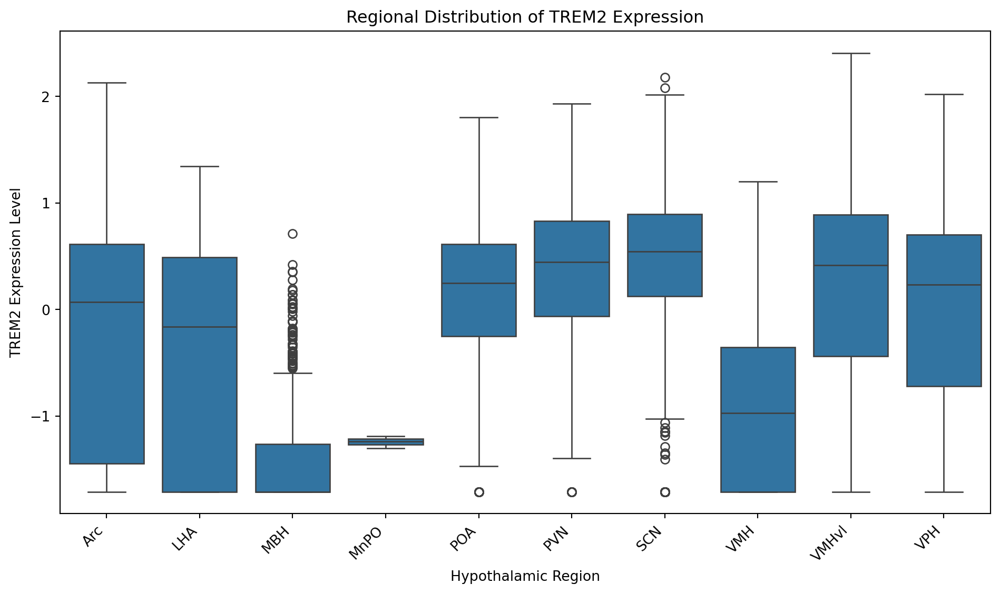

In [14]:
#| label: fig-trem2-region
#| fig-cap: TREM2 expression levels across different hypothalamic regions. Box plots show the median, quartiles, and distribution of TREM2 expression in each anatomically distinct region. Whiskers extend to 1.5 times the interquartile range.
plt.figure(figsize=(10, 6))
sns.boxplot(data=trem2_data, x='Region', y='Trem2')
plt.xticks(rotation=45, ha='right')
plt.xlabel('Hypothalamic Region')
plt.ylabel('TREM2 Expression Level')
plt.title('Regional Distribution of TREM2 Expression')
plt.tight_layout()

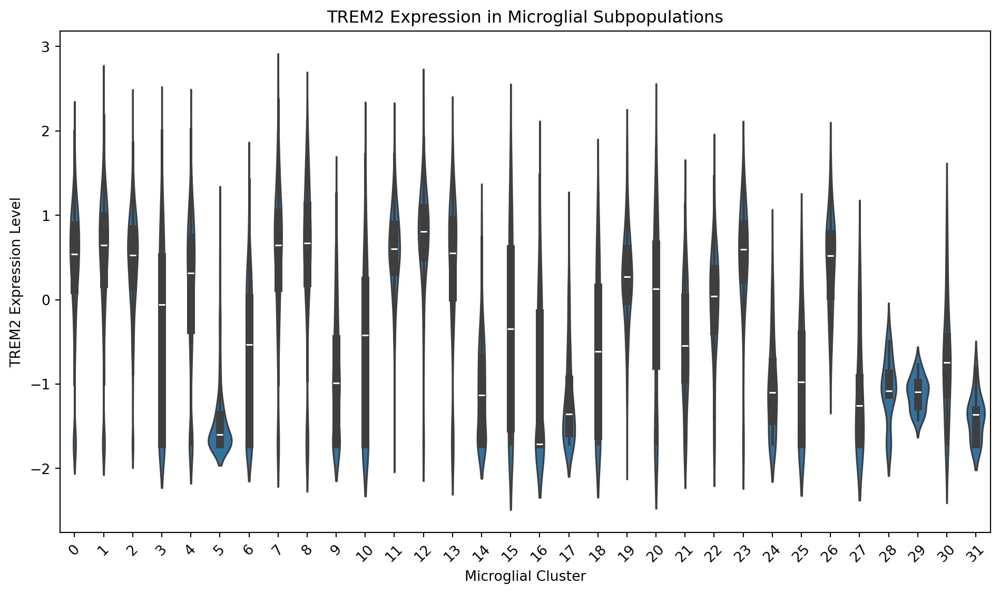

In [15]:
#| label: fig-trem2-clusters
#| fig-cap: Distribution of TREM2 expression across identified microglial clusters. Violin plots demonstrate the full distribution of expression levels within each cluster, with embedded box plots showing median and quartile values.
plt.figure(figsize=(10, 6))
sns.violinplot(data=trem2_data, x='Cluster', y='Trem2')
plt.xticks(rotation=45)
plt.xlabel('Microglial Cluster')
plt.ylabel('TREM2 Expression Level')
plt.title('TREM2 Expression in Microglial Subpopulations')
plt.tight_layout()

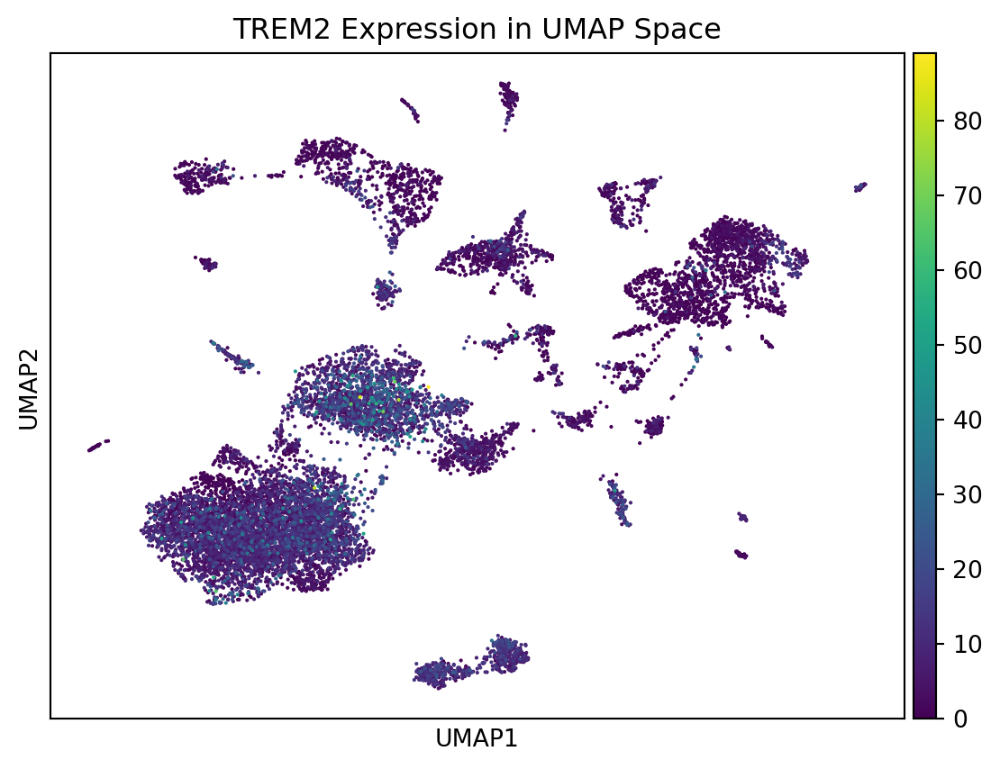

In [16]:
#| label: fig-trem2-umap
#| fig-cap: UMAP visualization of TREM2 expression across all microglia. Color intensity represents TREM2 expression level, showing the spatial distribution of TREM2-expressing cells in the reduced dimensional space.
plt.figure(figsize=(8, 8))
sc.pl.umap(adata_microglia, color='Trem2', show=True, title='TREM2 Expression in UMAP Space')
plt.tight_layout()

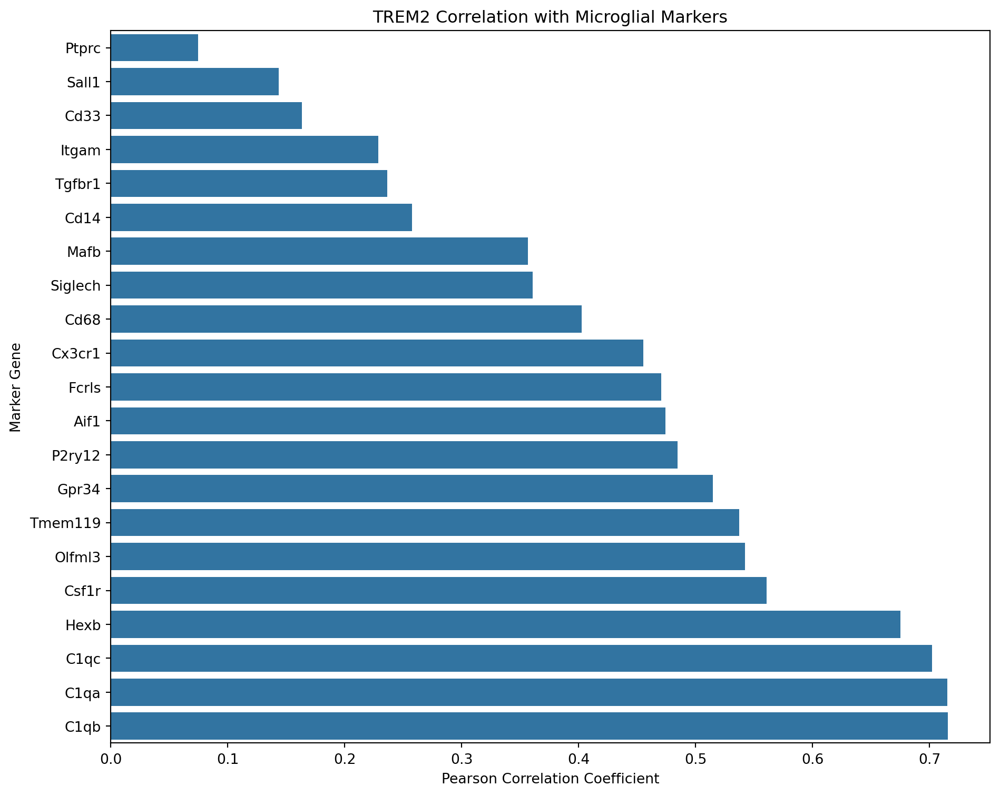

In [17]:
#| label: fig-trem2-correlations
#| fig-cap: Correlation analysis between TREM2 and other microglial marker genes. Bar plot shows Pearson correlation coefficients, ordered by strength of correlation. Positive values indicate positive correlation, while negative values indicate inverse relationships.
plt.figure(figsize=(10, 8))
sns.barplot(data=trem2_correlations, x='Correlation', y='Marker')
plt.title('TREM2 Correlation with Microglial Markers')
plt.xlabel('Pearson Correlation Coefficient')
plt.ylabel('Marker Gene')
plt.tight_layout()

In [18]:
#| label: trem2-statistics
#| output: false
from scipy import stats
import statsmodels.stats.multitest as mt

def trem2_statistics(trem2_data):
    # 1. One-way ANOVA for regional differences
    regions_list = [group['Trem2'].values for name, group in trem2_data.groupby('Region')]
    
    # Check if we have enough groups for ANOVA
    if len(regions_list) < 2:
        print("Warning: Not enough regions for ANOVA")
        f_stat, p_val = np.nan, np.nan
    else:
        f_stat, p_val = stats.f_oneway(*regions_list)
    
    # 2. Pairwise t-tests between regions
    unique_regions = sorted(trem2_data['Region'].unique())
    pairwise_tests = []
    
    for i in range(len(unique_regions)):
        for j in range(i+1, len(unique_regions)):
            reg1 = unique_regions[i]
            reg2 = unique_regions[j]
            
            data1 = trem2_data[trem2_data['Region'] == reg1]['Trem2']
            data2 = trem2_data[trem2_data['Region'] == reg2]['Trem2']
            
            # Only perform test if both groups have data
            if len(data1) > 0 and len(data2) > 0:
                t_stat, p_val = stats.ttest_ind(data1, data2)
                
                # Calculate effect size (Cohen's d)
                pooled_std = np.sqrt(
                    ((len(data1) - 1) * data1.std()**2 + 
                     (len(data2) - 1) * data2.std()**2) / 
                    (len(data1) + len(data2) - 2)
                )
                cohens_d = (data1.mean() - data2.mean()) / pooled_std
                
                pairwise_tests.append({
                    'Region1': reg1,
                    'Region2': reg2,
                    'Mean1': data1.mean(),
                    'Mean2': data2.mean(),
                    'N1': len(data1),
                    'N2': len(data2),
                    't_statistic': t_stat,
                    'p_value': p_val,
                    'cohens_d': cohens_d
                })
    
    # Apply Benjamini-Hochberg correction to p-values
    if pairwise_tests:
        pairwise_df = pd.DataFrame(pairwise_tests)
        _, p_adjusted, _, _ = mt.multipletests(
            pairwise_df['p_value'].values,
            method='fdr_bh'
        )
        pairwise_df['p_value_adj'] = p_adjusted
        
        # Sort by adjusted p-value
        pairwise_df = pairwise_df.sort_values('p_value_adj')
    else:
        pairwise_df = pd.DataFrame()
    
    # Create results dictionary
    stats_results = {
        'anova': {'f_statistic': f_stat, 'p_value': p_val},
        'pairwise_tests': pairwise_df
    }
    
    # Save results with more detailed formatting
    with open(output_dir / 'trem2_statistics.txt', 'w') as f:
        f.write('TREM2 Expression Analysis Across Hypothalamic Regions\n')
        f.write('='*50 + '\n\n')
        
        f.write('1. One-way ANOVA results:\n')
        f.write('-'*30 + '\n')
        f.write(f'F-statistic: {f_stat:.4f}\n')
        f.write(f'p-value: {p_val:.4e}\n\n')
        
        f.write('2. Regional Expression Summary:\n')
        f.write('-'*30 + '\n')
        summary_stats = trem2_data.groupby('Region')['Trem2'].agg(['count', 'mean', 'std'])
        f.write(summary_stats.to_string() + '\n\n')
        
        f.write('3. Pairwise Comparisons:\n')
        f.write('-'*30 + '\n')
        if not pairwise_df.empty:
            # Format floating point numbers
            formatted_df = pairwise_df.copy()
            float_cols = ['Mean1', 'Mean2', 't_statistic', 'p_value', 'p_value_adj', 'cohens_d']
            for col in float_cols:
                formatted_df[col] = formatted_df[col].map('{:.4e}'.format)
            f.write(formatted_df.to_string())
    
    return stats_results

# Run the analysis
trem2_stats = trem2_statistics(trem2_data)

/tmp/ipykernel_21742/3657118994.py:6: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipykernel_21742/3657118994.py:83: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


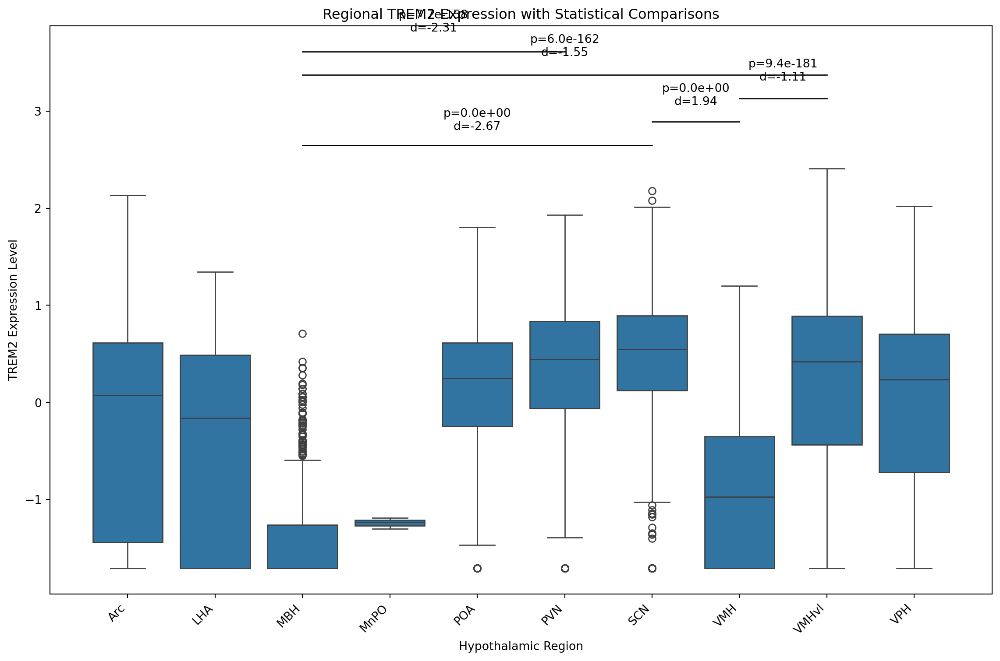

In [19]:
#| label: fig-trem2-regional-stats
#| fig-cap: Statistical comparison of TREM2 expression across hypothalamic regions. Box plots show the distribution of TREM2 expression levels in each region. Significance bars indicate the top 5 most significant pairwise comparisons (FDR-corrected p-values). Cohen's d effect sizes are shown for each comparison, quantifying the magnitude of expression differences between regions.
# Create visualization of the statistical results
plt.figure(figsize=(12, 8))
sns.boxplot(data=trem2_data, x='Region', y='Trem2')
plt.xticks(rotation=45, ha='right')
plt.xlabel('Hypothalamic Region')
plt.ylabel('TREM2 Expression Level')
plt.title('Regional TREM2 Expression with Statistical Comparisons')

# Add significance annotations for top significant comparisons
if not trem2_stats['pairwise_tests'].empty:
    max_y = trem2_data['Trem2'].max()
    y_pos = max_y * 1.1
    
    # Get top 5 most significant comparisons
    top_comparisons = trem2_stats['pairwise_tests'].head(5)
    
    # Get ordered list of regions for proper indexing
    region_order = pd.Categorical(trem2_data['Region']).categories
    
    for idx, row in top_comparisons.iterrows():
        try:
            # Find indices in the ordered region list
            x1 = np.where([r == row['Region1'] for r in region_order])[0][0]
            x2 = np.where([r == row['Region2'] for r in region_order])[0][0]
            
            plt.plot([x1, x2], [y_pos, y_pos], 'k-', linewidth=1)
            plt.text((x1 + x2) / 2, y_pos * 1.05,
                    f"p={row['p_value_adj']:.1e}\nd={row['cohens_d']:.2f}",
                    ha='center', va='bottom')
            y_pos += max_y * 0.1
        except IndexError:
            continue

plt.tight_layout()

/tmp/ipykernel_21742/1971043812.py:6: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


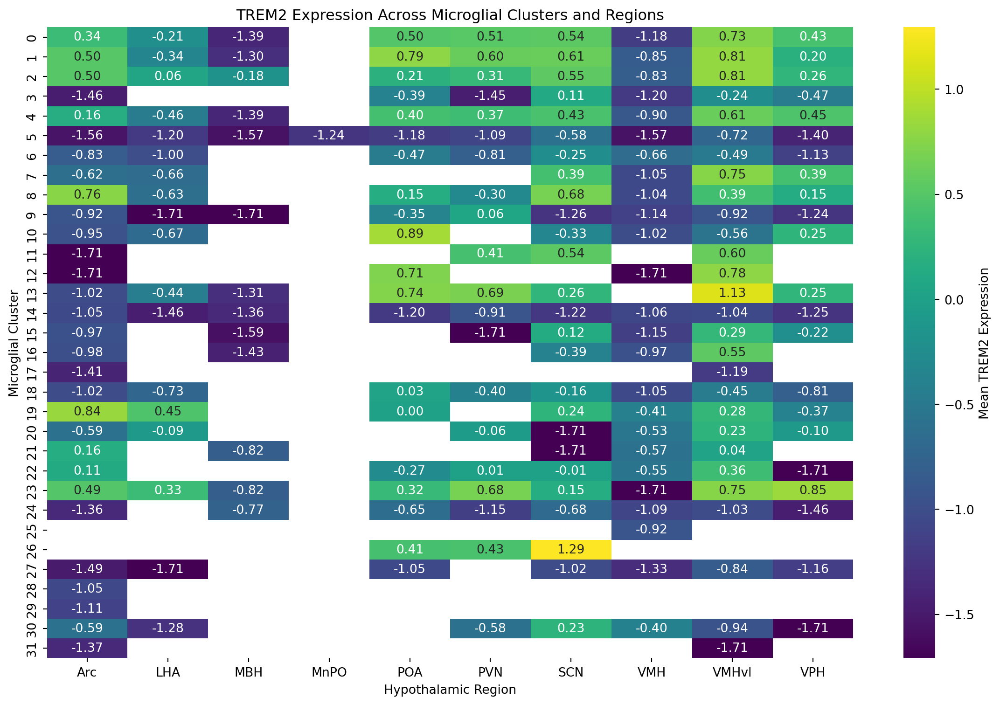

In [20]:
#| label: fig-trem2-cluster-enrichment-heatmap
#| fig-cap: Regional and cluster-specific TREM2 expression patterns. Heatmap shows mean TREM2 expression levels across different microglial clusters (rows) and hypothalamic regions (columns). Color intensity represents expression level, with darker colors indicating higher expression.
def analyze_trem2_clusters(adata):
    cluster_means = pd.DataFrame({
        'Trem2_mean': adata[:, 'Trem2'].X.toarray().flatten(),
        'Cluster': adata.obs['leiden_integrated'],
        'Region': adata.obs['region']
    }).groupby(['Cluster', 'Region'])['Trem2_mean'].mean().reset_index()
    
    pivot_table = cluster_means.pivot(
        index='Cluster',
        columns='Region',
        values='Trem2_mean'
    )
    
    plt.figure(figsize=(12, 8))
    sns.heatmap(pivot_table, cmap='viridis', annot=True, fmt='.2f', 
                cbar_kws={'label': 'Mean TREM2 Expression'})
    plt.title('TREM2 Expression Across Microglial Clusters and Regions')
    plt.xlabel('Hypothalamic Region')
    plt.ylabel('Microglial Cluster')
    plt.tight_layout()
    
    return cluster_means

trem2_cluster_data = analyze_trem2_clusters(adata_microglia)

/opt/conda/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

/opt/conda/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning:

invalid value encountered in divide


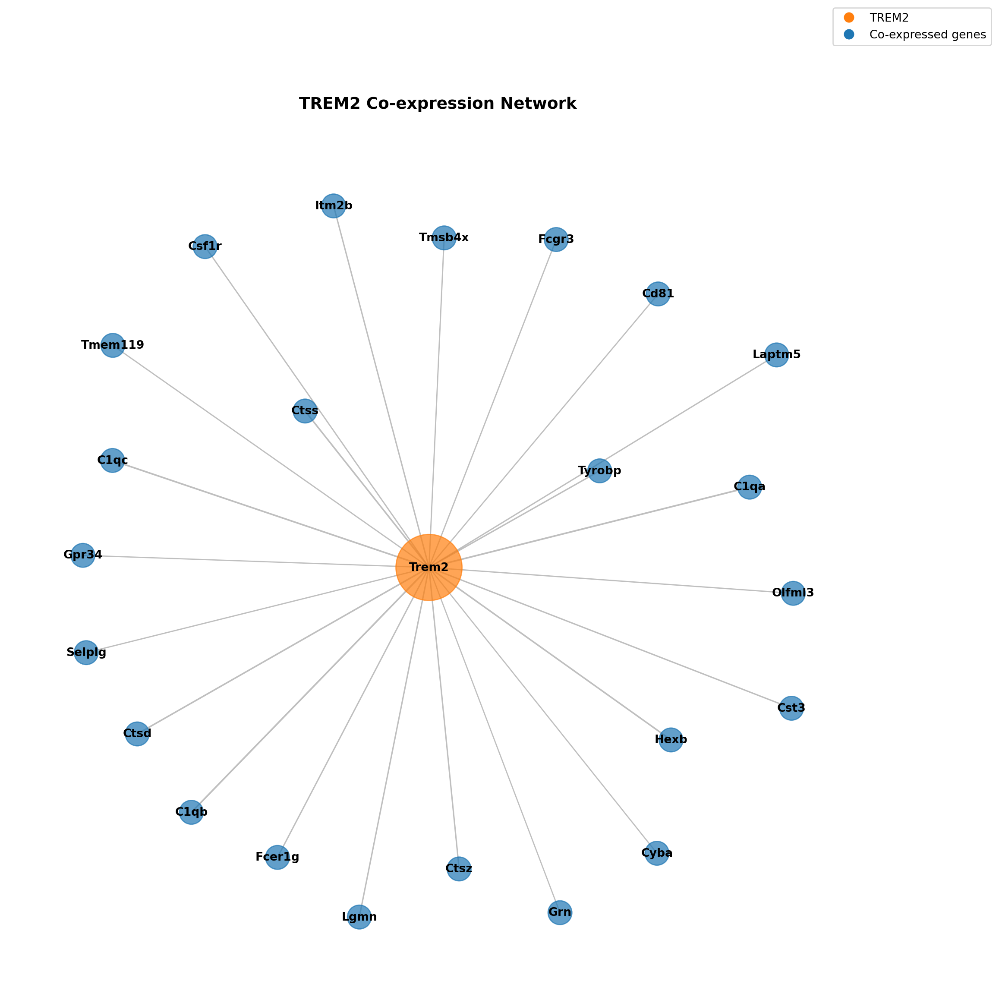


Network Statistics:
Number of co-expressed genes: 23
Number of connections: 23

Network Metrics:
Network density: 0.083
Average clustering coefficient: 0.000

In [21]:
#| label: fig-trem2-coexpression-network
#| fig-cap: TREM2 co-expression network in hypothalamic microglia. Nodes represent genes, with TREM2 as the central hub. Edge weights represent the absolute Pearson correlation coefficient between gene pairs. Only correlations above 0.3 are shown.
import networkx as nx
import matplotlib.pyplot as plt
import scipy.sparse
import numpy as np
import pandas as pd

def create_trem2_network(adata, correlation_threshold=0.5):
    """
    Create and visualize a TREM2-centered gene co-expression network.
    
    Parameters:
    -----------
    adata : AnnData
        Annotated data matrix containing gene expression data
    correlation_threshold : float
        Minimum absolute correlation coefficient to include in the network
        
    Returns:
    --------
    G : networkx.Graph
        Network graph object containing the co-expression relationships
    """
    # Verify Trem2 is in the dataset
    if 'Trem2' not in adata.var_names:
        raise ValueError("Trem2 gene not found in the dataset")
    
    try:
        # Get expression matrix - handle both sparse and dense formats
        if scipy.sparse.issparse(adata.X):
            expr_matrix = adata.X.toarray()
        else:
            expr_matrix = np.array(adata.X)
        
        # Verify matrix is not empty and contains valid values
        if expr_matrix.size == 0 or np.all(np.isnan(expr_matrix)):
            raise ValueError("Expression matrix is empty or contains invalid values")
        
        # Calculate correlation matrix for genes
        correlation_matrix = pd.DataFrame(
            np.corrcoef(expr_matrix.T),
            index=adata.var_names,
            columns=adata.var_names
        )
        
        # Create network
        G = nx.Graph()
        
        # Add edges for genes correlated with Trem2
        trem2_correlations = correlation_matrix['Trem2'].abs()
        
        # Filter and add edges
        for gene in trem2_correlations.index:
            if gene != 'Trem2' and trem2_correlations[gene] > correlation_threshold:
                G.add_edge('Trem2', gene, weight=float(trem2_correlations[gene]))
        
        # Check if network is empty
        if len(G.nodes()) < 2:
            print("Warning: No genes pass correlation threshold")
            return G
        
        # Calculate node sizes based on degree centrality
        degree_centrality = nx.degree_centrality(G)
        node_sizes = [3000 * (degree_centrality[node] + 0.1) for node in G.nodes()]
        
        # Calculate edge weights for visualization
        edge_weights = [G[u][v]['weight'] * 2 for u, v in G.edges()]
        
        # Create color map based on correlation with TREM2
        node_colors = ['#ff7f0e' if node == 'Trem2' else '#1f77b4' for node in G.nodes()]
        
        # Create new figure
        plt.figure(figsize=(12, 12))
        
        # Calculate layout
        pos = nx.spring_layout(G, k=1, iterations=50, seed=42)
        
        # Draw network components
        nx.draw_networkx_edges(
            G, pos,
            width=edge_weights,
            alpha=0.5,
            edge_color='gray'
        )
        
        nx.draw_networkx_nodes(
            G, pos,
            node_size=node_sizes,
            node_color=node_colors,
            alpha=0.7
        )
        
        nx.draw_networkx_labels(
            G, pos,
            font_size=10,
            font_weight='bold',
            font_color='black'
        )
        
        plt.title('TREM2 Co-expression Network', 
                 pad=20, size=14, weight='bold')
        
        # Add legend with explicit handles
        legend_elements = [
            plt.Line2D([0], [0], marker='o', color='w', 
                      markerfacecolor='#ff7f0e', label='TREM2', markersize=10),
            plt.Line2D([0], [0], marker='o', color='w', 
                      markerfacecolor='#1f77b4', label='Co-expressed genes', markersize=10)
        ]
        plt.legend(handles=legend_elements, loc='upper right', bbox_to_anchor=(1.15, 1.15))
        
        plt.axis('off')
        plt.tight_layout()
        plt.show()
        
        # Save figure
        plt.savefig(output_dir / 'trem2_network.pdf', bbox_inches='tight', dpi=300)
        plt.close()
        
        return G
        
    except Exception as e:
        print(f"Error in network creation: {str(e)}")
        return None

# Create network with improved error handling
try:
    trem2_network = create_trem2_network(adata_microglia)
    
    if trem2_network is not None:
        print("\nNetwork Statistics:")
        print(f"Number of co-expressed genes: {len(trem2_network.nodes()) - 1}")
        print(f"Number of connections: {len(trem2_network.edges())}")
        
        # Calculate and print additional network metrics
        print("\nNetwork Metrics:")
        print(f"Network density: {nx.density(trem2_network):.3f}")
        print(f"Average clustering coefficient: {nx.average_clustering(trem2_network):.3f}")
        
except Exception as e:
    print(f"Failed to create network: {str(e)}")